In [1]:
import xarray as xr
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import matplotlib.colors
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy.stats import chi2
from numba import njit,prange

import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth

In [2]:

normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}

imin = 32 ; imax = -30
jmin = 20 ; jmax = -15
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-ERA-20C/MARgrid_EUf.nc')
lon = ds.LON[jmin:jmax,imin:imax]
lat = ds.LAT[jmin:jmax,imin:imax]


In [3]:
def Qgev(μ,σ,ξ,q):
    Q = np.zeros(np.shape(μ))
    gumbel = np.abs(ξ)<10**-3
    gev = np.logical_not(gumbel)
    Q[gumbel] = μ[gumbel] - σ[gumbel]*np.log(-np.log(q))
    Q[gev] = μ[gev] + σ[gev]/ξ[gev]*((-np.log(q))**(-ξ[gev]) -1)
    return Q

In [4]:
#Minimization algorithm
@njit()
def nelder_mead(f, x_start ,args=(),
                step=0.1, no_improve_thr=1e-8,
                no_improv_break=10, max_iter=200,
                alpha=1., gamma=2., rho=-0.5, sigma=0.5):
    '''
        Pure Python/Numpy implementation of the Nelder-Mead algorithm.
        Reference: https://en.wikipedia.org/wiki/Nelder%E2%80%93Mead_method
        https://www.youtube.com/watch?v=vOYlVvT3W80
        
        
        @param f (function): function to minimize, must return a scalar score
            and operate over a numpy array of the same dimensions as x_start
        @param x_start (numpy array): initial position
        @param step (float): look-around radius in initial step
        @no_improv_thr,  no_improv_break (float, int): break after no_improv_break iterations with
            an improvement lower than no_improv_thr
        @max_iter (int): always break after this number of iterations.
            Set it to 0 to loop indefinitely.
        @alpha, gamma, rho, sigma (floats): parameters of the algorithm
            (see Wikipedia page for reference)
        return: tuple (best parameter array, best score, iterations)
    '''

    # init
    dim = len(x_start)
    prev_best = f(x_start, *args)
    no_improv = 0
    
    points = np.zeros((dim+1,dim))
    scores = np.zeros((dim+1))
    
    points[0]=x_start ; scores[0]=prev_best
    
    for i in range(1,dim+1):
        points[i] = np.copy(x_start)
        points[i,i-1] += step
        scores[i] = f(points[i], *args)

    # simplex iter
    iters = 0
    # break after max_iter
    while iters < max_iter:
        iters += 1
        
        # order
        ss = np.argsort(scores)
        points = points[ss]
        scores = scores[ss]
        best = scores[0] 
        

        # break after no_improv_break iterations with no improvement
        # print( '...best so far:', best)

        if best < prev_best - no_improve_thr:
            no_improv = 0
            prev_best = best
        else:
            no_improv += 1

        if no_improv >= no_improv_break:
            return points[0],scores[0],iters

        # centroid
        x0 = np.sum(points[:-1],axis=0)/dim
        # reflection
        xr = x0 + alpha*(x0 - points[-1])
        rscore = f(xr, *args)
        if scores[0] <= rscore < scores[-2]:
            points[-1] = xr
            scores[-1] = rscore
            continue

        # expansion
        if rscore < scores[0]:
            xe = x0 + gamma*(x0 - points[-1])
            escore = f(xe, *args)
            if escore < rscore:
                points[-1] = xe
                scores[-1] = escore
                continue
            else:
                points[-1] = xr
                scores[-1] = rscore
                continue

        # contraction
        xc = x0 + rho*(x0 - points[-1])
        cscore = f(xc, *args)
        if cscore < scores[-1]:
            points[-1] = xc
            scores[-1] = cscore
            continue

        # reduction
        for i in range(1,dim+1):
            points[i] = points[0] + sigma*(points[i] - points[0])
            scores[i] = f(points[i], *args)
        
    return points[0],scores[0],iters

### Gumbel fit
@njit()
def gumbel_nllh(params,x):
    μ,σ = params
    s = (x-μ)/σ
    return np.sum(np.log(σ)+s+np.exp(-s))

@njit()
def fit_gumbel(x):
    '''
    Algorithm derived in this video : https://www.youtube.com/watch?v=p818JALlO44
    '''
    x_ = np.mean(x)
    σ = np.sqrt(np.sum((x-x_)**2)/(np.shape(x)[0]-1) *6)/np.pi
    if σ==0. or x_==np.nan:
        return np.array([ np.nan , np.nan])
    for i in range(4):
        e = np.exp(-x/σ)
        e_ = np.mean(e)
        xe_ = np.mean(x*e)
        σ -= (σ - x_ + xe_/e_) / (1+ ( e_*np.mean(x**2*e) - xe_**2 )/e_**2/σ**2)
    return np.array([ -σ*np.log(np.mean(np.exp(-x/σ))) , σ ])

### GEV fit
@njit()
def gev_nllh(params,x):
    μ,σ,ξ = params
    if ξ==0.:
        return gumbel_nllh(params[:2],x)
    a = 1+ξ*(x-μ)/σ
    a[a<0.001]=0.001
    nllhs = np.log(σ) + (1+1/ξ)*np.log(a) + a**(-1/ξ)
    nllhs[a==0.001] = 100
    return np.sum(nllhs)

### NS-GEV fit
@njit()
def nsgev_nllh(params,x):
    μ0,σ0,ξ,μt,σt = params
    y = np.arange(-(len(x)-1)/2,(len(x)+1)/2)
    if ξ==0.:
        s = (x-μ0-y*μt)/(σ0+y*σt)
        return np.sum(np.log(σ0+y*σt)+s+np.exp(-s))
    
    a = 1+ξ*(x-μ0-y*μt)/(σ0+y*σt)
    a[a<0.001]=0.001
    nllhs = np.log(σ0+y*σt) + (1+1/ξ)*np.log(a) + a**(-1/ξ)
    nllhs[a==0.001] = 100
    return np.sum(nllhs)

@njit()
def nsgev_nllh_fit(params,x,gev_params):
    μt,σt = params
    μ0,σ0,ξ = gev_params
    y = np.arange(-(len(x)-1)/2,(len(x)+1)/2)
    if ξ==0.:
        s = (x-μ0-y*μt)/(σ0+y*σt)
        return np.sum(np.log(σ0+y*σt)+s+np.exp(-s))
    
    a = 1+ξ*(x-μ0-y*μt)/(σ0+y*σt)
    a[a<0.001]=0.001
    nllhs = np.log(σ0+y*σt) + (1+1/ξ)*np.log(a) + a**(-1/ξ)
    nllhs[a==0.001] = 100
    return np.sum(nllhs)

@njit()
def fit_nsgev(x):
    μ,σ = fit_gumbel(x)
    params,nllh0 = nelder_mead(gev_nllh, np.array([μ,σ,0.]),args=(x,),step=0.05,no_improve_thr=1e-6)[:2]
    μ,σ,ξ = params
    μt,σt = nelder_mead(nsgev_nllh_fit, np.array([0.,0.]),args=(x,np.array([μ,σ,ξ,])),step=0.1,no_improve_thr=1e-3)[0]
    params,nllh1 = nelder_mead(nsgev_nllh, np.array([μ,σ,ξ,μt,σt]),args=(x,),step=0.001,no_improve_thr=1e-6)[:2]
    return params, 2*(nllh0-nllh1)
    
@njit(parallel=False)
def seasonal_nsgev_signif(les_season_max):
    nt,ns,nlat,nlon = np.shape(les_season_max)
    season_mu_sig_xi_mut_sigt = np.zeros((ns,nlat,nlon,5))
    season_signif = np.zeros((ns,nlat,nlon))
    for s in prange(ns):
        for j in prange(nlat):
            for i in prange(nlon):
                season_mu_sig_xi_mut_sigt[s,j,i] , season_signif[s,j,i] = fit_nsgev(les_season_max[:,s,j,i])
    return season_mu_sig_xi_mut_sigt,season_signif

def seasonal_nsgev_pvalue(les_season_max):
    params , signif = seasonal_nsgev_signif(les_season_max)
    return params , 1 - chi2.cdf(signif,2)

In [5]:
models = ['MAR_MPI','MAR_ECearth3','MAR_MPI85','MAR_ERA20C']#,'E-OBS','MAR_ERA20C']#,'MAR_ERA5',,'APGD']
# timelines = np.array([[1902,2010],[1980,2020],[1961,2100],[1961,2100],[1971,2008]])
les_params = []
les_pvalue = []
for m,model in enumerate(models):
    print(model)
    les_season_max = np.load('/home/philinat/Stage-M2/saved_data_'+model+'/les_season_max.npy')[:,:,jmin:jmax,imin:imax]
    params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
    les_params.append(params)
    les_pvalue.append(pvalue)


MAR_MPI
MAR_ECearth3
MAR_MPI85
MAR_ERA20C


In [14]:
print(np.shape(np.array(les_params)))
print(np.shape(np.array(les_pvalue)))
nsgev_models = np.append(np.array(les_params),np.reshape(np.array(les_pvalue),np.shape(les_pvalue)+(1,)),axis=4)
print(np.shape(nsgev_models))
np.save('/home/philinat/Stage-M2/saved_nsgev/nsgev_models.npy',nsgev_models)

(4, 4, 91, 139, 5)
(4, 4, 91, 139)
(4, 4, 91, 139, 6)


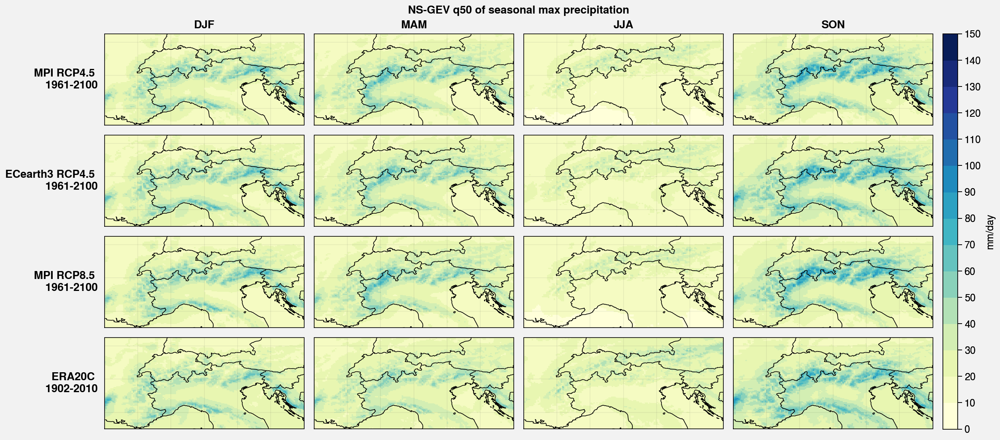

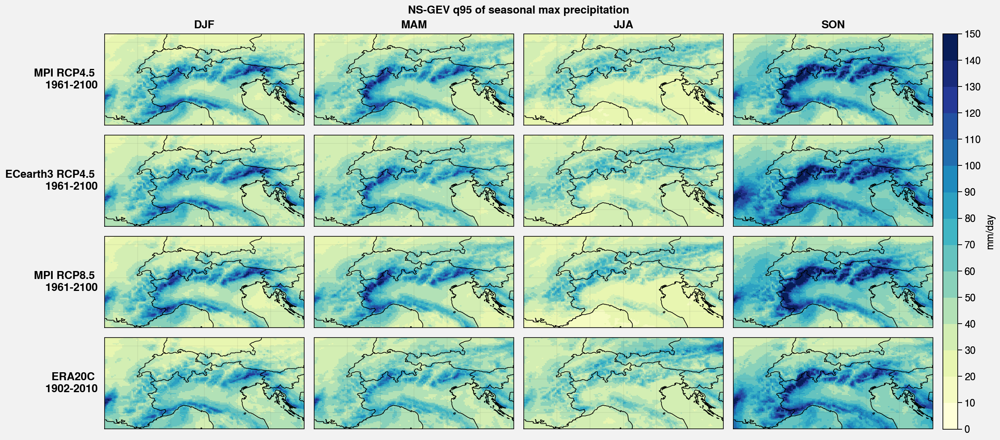

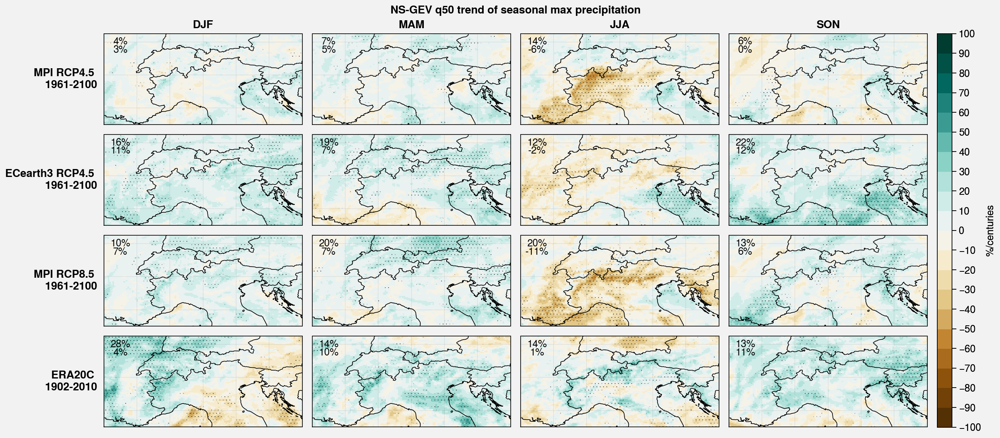

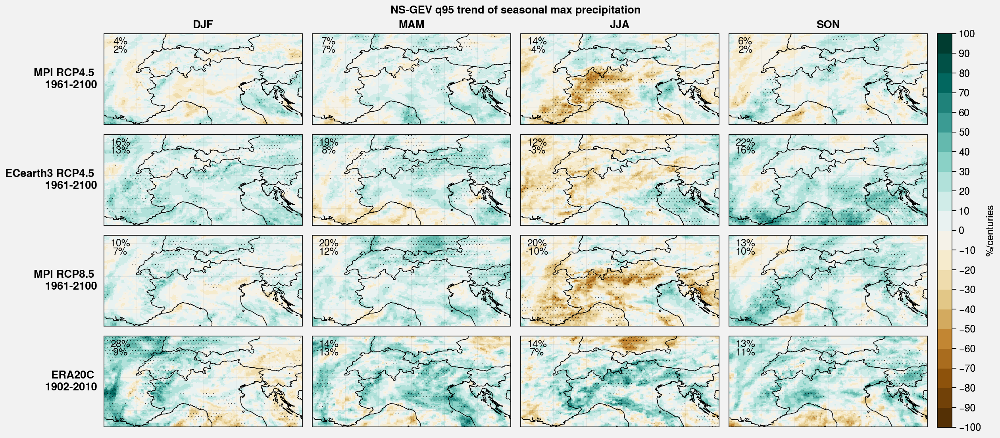

In [19]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_models.npy')[:]
for trend in [False,True]:
    for q in [50,95]:
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
                if trend:
                    Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
                    cb = ax.pcolormesh(lon,lat,100*100*Qt/Q0,levels=np.linspace(-100,100,21),cmap='BrBg')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                    ax.text(5,48,"{:.0%}".format(np.sum(signif)/np.size(signif)),ha='center',va='center')
                    # ax.text(5,47.5,"{:.0%}".format(np.mean(100*Qt/Q0)),ha='center',va='center')
                else:
                    cb = ax.pcolormesh(lon,lat,Q0,levels=np.linspace(0,150,16),cmap='YlGnBu')
        
        models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100','ERA20C \n 1902-2010']
        if trend: 
            f.colorbar(cb, label= '%/centuries')
            axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' trend of seasonal max precipitation',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)
        else: 
            f.colorbar(cb, label= 'mm/day')
            axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' of seasonal max precipitation',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

In [15]:
# models = ['MAR_MPI','MAR_ECearth3','EOBS']#,'MAR_ERA20C']#,'MAR_ERA5',,'APGD']
# timelines = np.array([[1961,2100],[1961,2100],[1950,2020]])
# les_params = []
# les_pvalue = []
# for m,model in enumerate(models):
#     print(model)
#     y1961 = 1961 - timelines[m,0]
#     y2020 = 2020 - timelines[m,0]+1
#     les_season_max = np.load('/home/philinat/Stage-M2/saved_data_'+model+'/les_season_max.npy')[:,:,jmin:jmax,imin:imax]
#     les_season_max = les_season_max[y1961:y2020,:,:,:]
    
#     params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
#     les_params.append(params)
#     les_pvalue.append(pvalue)

EOBS


In [27]:
models = ['MAR_ERA5','APGD','EOBS']
les_params = []
les_pvalue = []
for m,model in enumerate(models):
    print(model)
    les_season_max = np.load('/home/philinat/Stage-M2/saved_data_'+model+'/les_season_max.npy')[:,:,jmin:jmax,imin:imax]
    params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
    les_params.append(params)
    les_pvalue.append(pvalue)


MAR_ERA5
APGD
E-OBS


FileNotFoundError: [Errno 2] No such file or directory: '/home/philinat/Stage-M2/saved_data_E-OBS/les_season_max.npy'

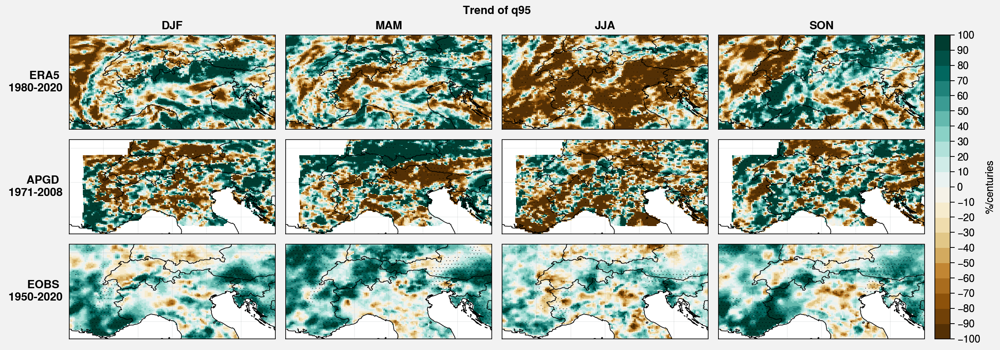

In [39]:
nsgev_models = np.append(np.array(les_params),np.reshape(np.array(les_pvalue),np.shape(les_pvalue)+(1,)),axis=4)
for q in [95]:
    f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
    for m,params in enumerate(nsgev_models):

        for i in range(4):
            ax = axs[i+m*4]
            Q095 = params[i,:,:,0]+params[i,:,:,1]/params[i,:,:,2]*((-np.log(q/100))**(-params[i,:,:,2]) -1)
            Qt95 = params[i,:,:,3]+params[i,:,:,4]/params[i,:,:,2]*((-np.log(q/100))**(-params[i,:,:,2]) -1)
            cb = ax.pcolormesh(lon,lat,100*100*Qt95/Q095,levels=np.linspace(-100,100,21),cmap='BrBg')

            signif=np.where(params[i,:,:,5]<0.05,True,False)
            p = ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)#
    f.colorbar(cb, label= '%/centuries')
    
    models = ['ERA5 \n 1980-2020','APGD \n 1971-2008','EOBS \n 1950-2020']
    axs.format(**multiplot_format,suptitle='Trend of q'+str(q),collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

In [5]:
models = ['MAR_MPI','MAR_ECearth3','MAR_MPI85']
timelines = np.array([[1961,2100],[1961,2100],[1961,2100]])
les_params = []
les_pvalue = []
for m,model in enumerate(models):
    print(model)
    y2020 = 2020 - timelines[m,0]
    les_season_max = np.load('/home/philinat/Stage-M2/saved_data_'+model+'/les_season_max.npy')[:,:,jmin:jmax,imin:imax]
    les_season_max = les_season_max[y2020:,:,:,:]
    
    params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
    les_params.append(params)
    les_pvalue.append(pvalue)

MAR_MPI
MAR_ECearth3
MAR_MPI85


In [7]:
nsgev_models2020 = np.append(np.array(les_params),np.reshape(np.array(les_pvalue),np.shape(les_pvalue)+(1,)),axis=4)
np.save('/home/philinat/Stage-M2/saved_nsgev/nsgev_models2020.npy',nsgev_models2020)

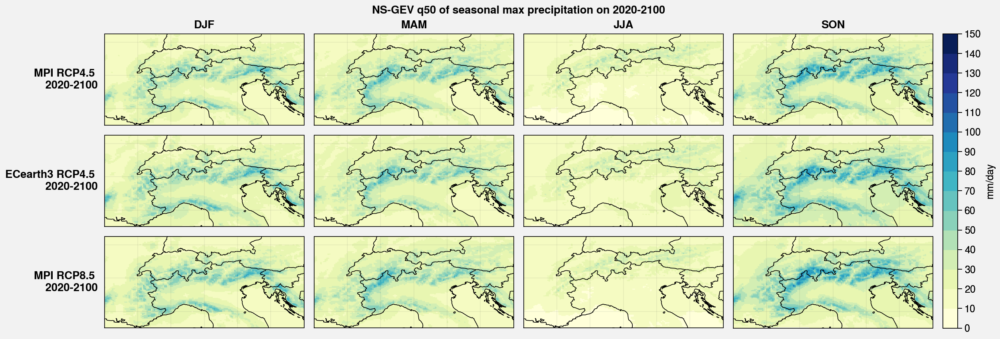

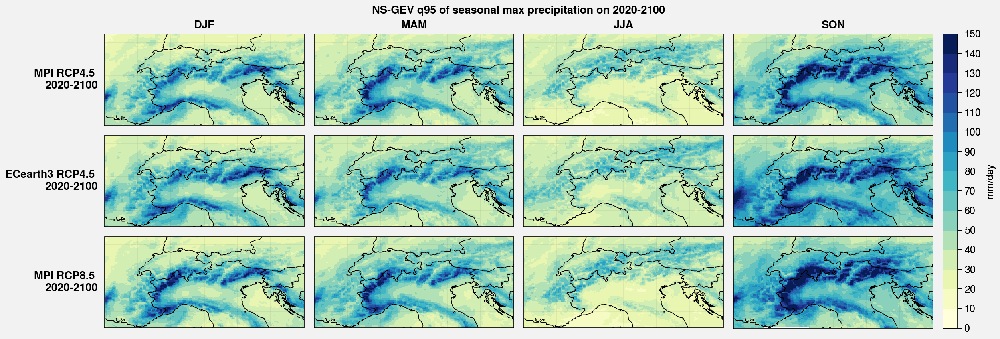

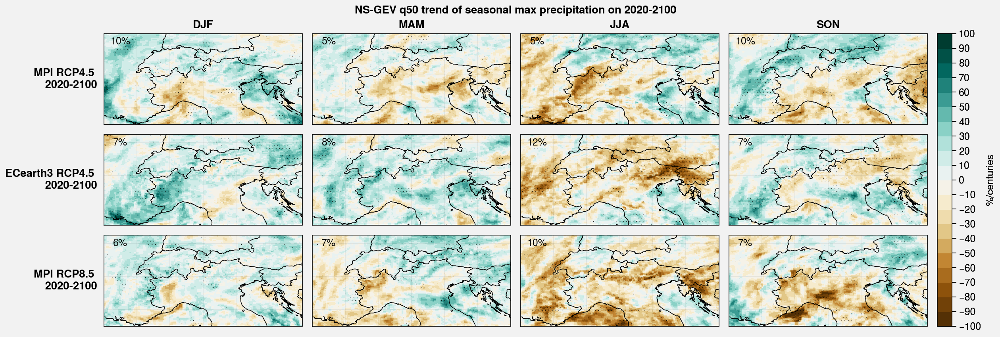

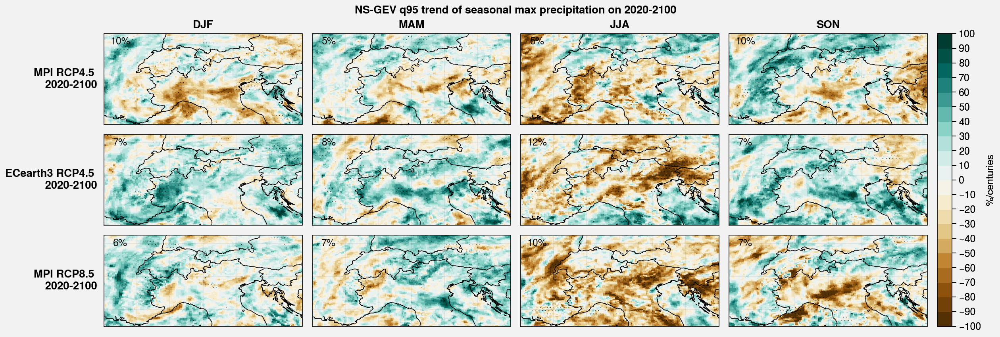

In [13]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_models2020.npy')
for trend in [False,True]:
    for q in [50,95]:
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
                if trend:
                    Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
                    cb = ax.pcolormesh(lon,lat,100*100*Qt/Q0,levels=np.linspace(-100,100,21),cmap='BrBg')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                    ax.text(5,48,"{:.0%}".format(np.sum(signif)/np.size(signif)),ha='center',va='center')
                else:
                    cb = ax.pcolormesh(lon,lat,Q0,levels=np.linspace(0,150,16),cmap='YlGnBu')
        models = ['MPI RCP4.5 \n 2020-2100','ECearth3 RCP4.5 \n 2020-2100','MPI RCP8.5 \n 2020-2100']#,'ERA5 \n 1980-2020']
        if trend: 
            f.colorbar(cb, label= '%/centuries')
            axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' trend of seasonal max precipitation on 2020-2100',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)
        else: 
            f.colorbar(cb, label= 'mm/day')
            axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' of seasonal max precipitation on 2020-2100',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)
        

In [40]:
models = ['MAR_MPI','MAR_ECearth3','MAR_MPI85','MAR_ERA20C','MAR_ERA5','EOBS']
les_params = []
les_pvalue = []
for m,model in enumerate(models):
    print(model)
    les_season_max = np.load('/home/philinat/Stage-M2/saved_data_'+model+'/les_season_maxT.npy')[:,:,jmin:jmax,imin:imax]
    params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
    les_params.append(params)
    les_pvalue.append(pvalue)


MAR_MPI
MAR_ECearth3
MAR_MPI85
MAR_ERA20C
MAR_ERA5
EOBS


In [41]:
nsgev_modelsT = np.append(np.array(les_params),np.reshape(np.array(les_pvalue),np.shape(les_pvalue)+(1,)),axis=4)
np.save('/home/philinat/Stage-M2/saved_nsgev/nsgev_modelsT.npy',nsgev_modelsT)

In [ ]:
models = ['MAR_MPI','MAR_ECearth3','MAR_MPI85']
timelines = np.array([[1961,2100],[1961,2100],[1961,2100]])
les_params = []
les_pvalue = []
for m,model in enumerate(models):
    print(model)
    y2020 = 2020 - timelines[m,0]
    les_season_max = np.load('/home/philinat/Stage-M2/saved_data_'+model+'/les_season_maxT.npy')[y2020:,:,jmin:jmax,imin:imax]
    params,pvalue = seasonal_nsgev_pvalue(les_season_max) # params=μ0,σ0,ξ,μt,σt
    les_params.append(params)
    les_pvalue.append(pvalue)

MAR_MPI


In [ ]:
nsgev_modelsT2020 = np.append(np.array(les_params),np.reshape(np.array(les_pvalue),np.shape(les_pvalue)+(1,)),axis=4)
np.save('/home/philinat/Stage-M2/saved_nsgev/nsgev_modelsT2020.npy',nsgev_modelsT2020)

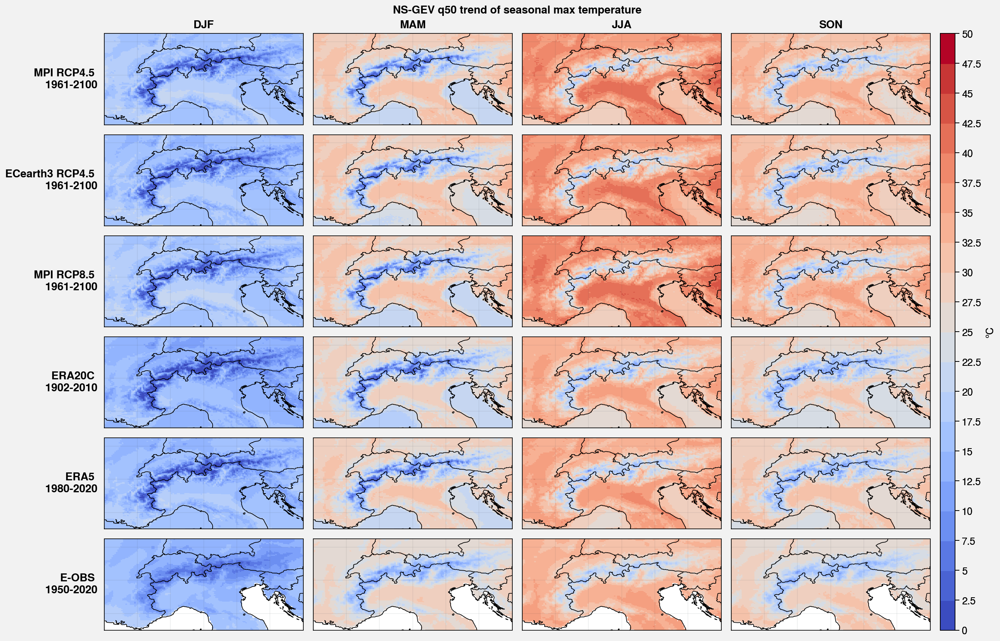

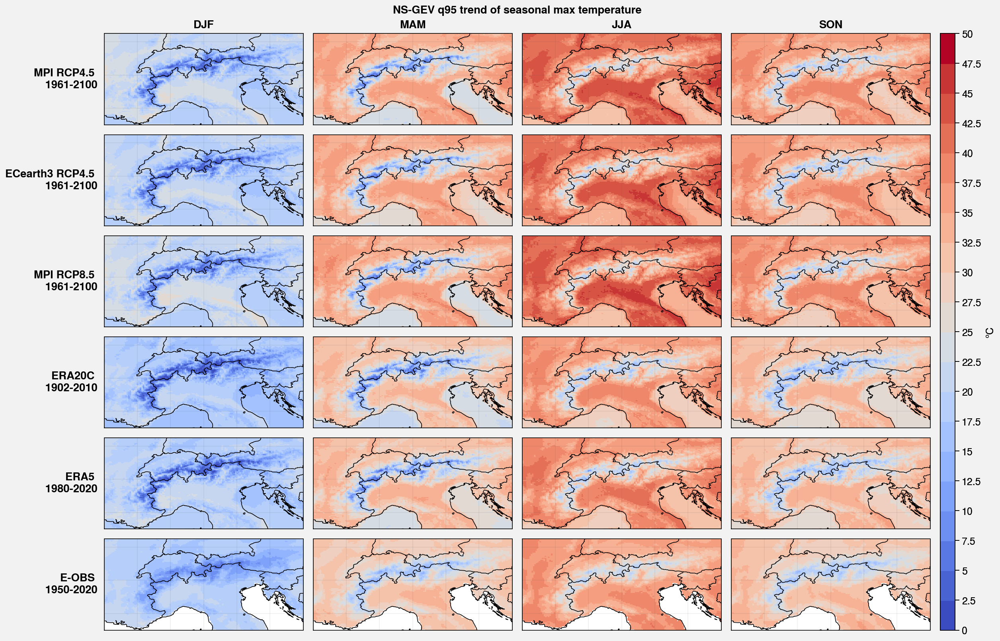

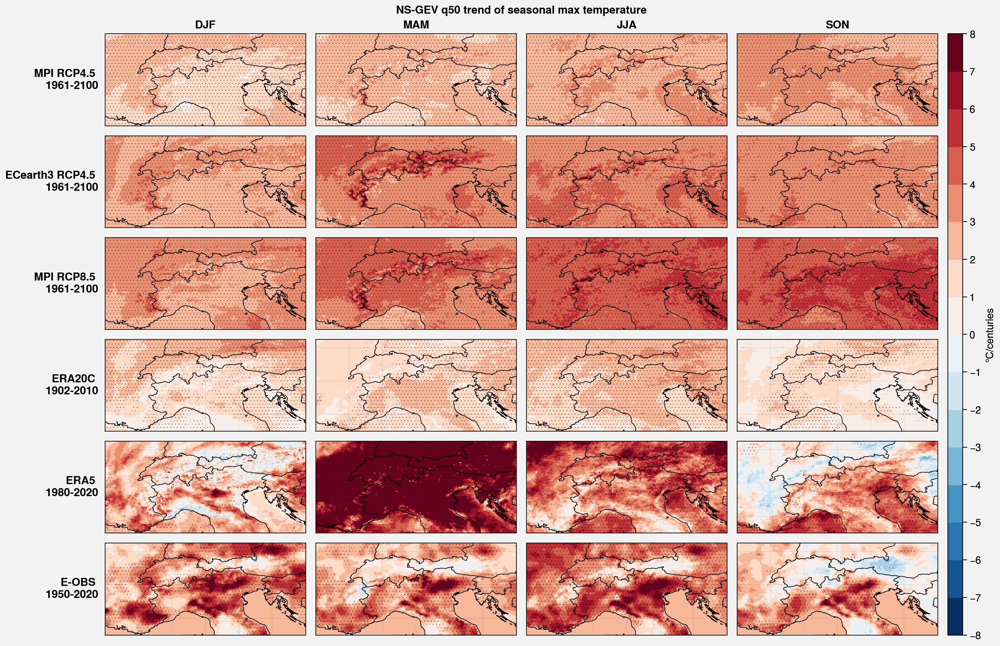

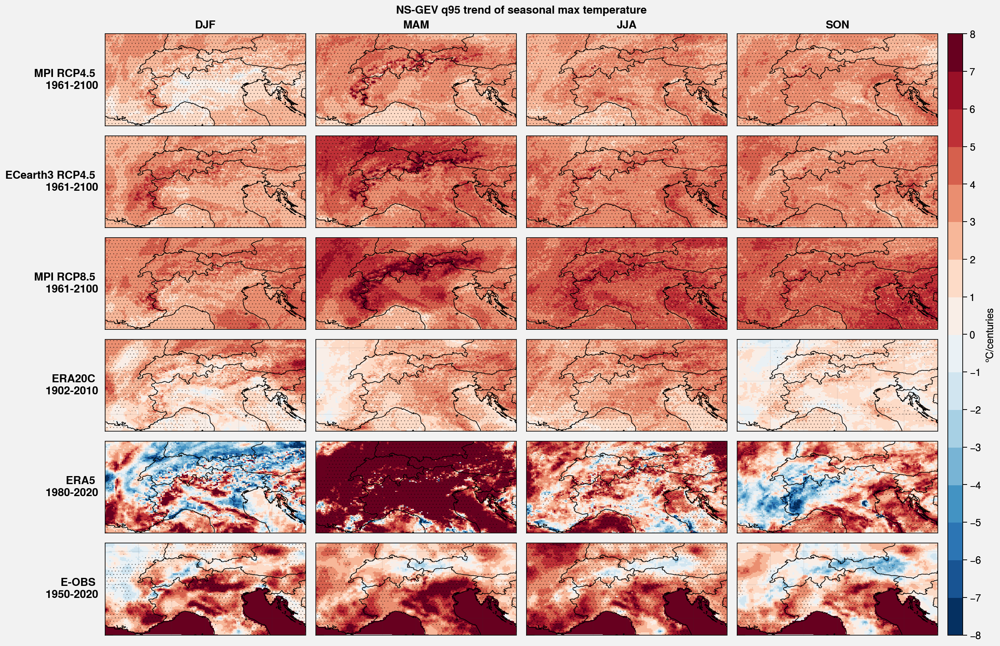

In [5]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_modelsT.npy')
for trend in [False,True]:
    for q in [50,95]:
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
                if trend:
                    Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
                    cb = ax.pcolormesh(lon,lat,100*Qt,levels=np.linspace(-8,8,17),cmap='RdBu_r')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                else:
                    cb = ax.pcolormesh(lon,lat,Q0,levels=np.linspace(0,50,21),cmap='coolwarm')
        if trend: f.colorbar(cb, label= '°C/centuries')  
        else: f.colorbar(cb, label= '°C')            
        models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100','ERA20C \n 1902-2010','ERA5 \n 1980-2020','E-OBS \n 1950-2020']
        axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' trend of seasonal max temperature',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

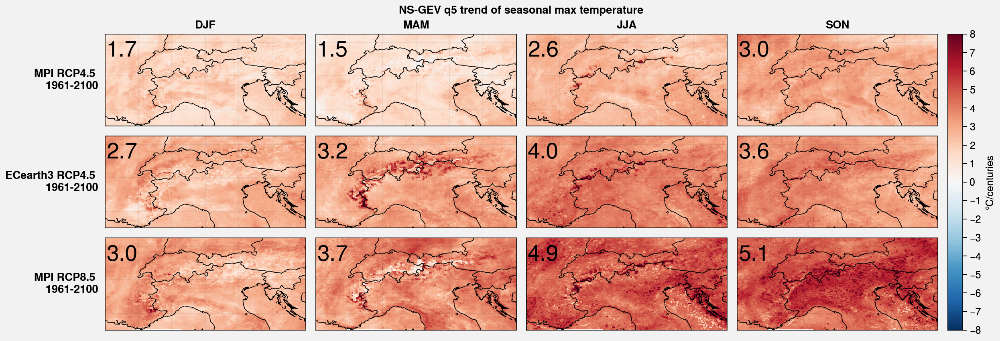

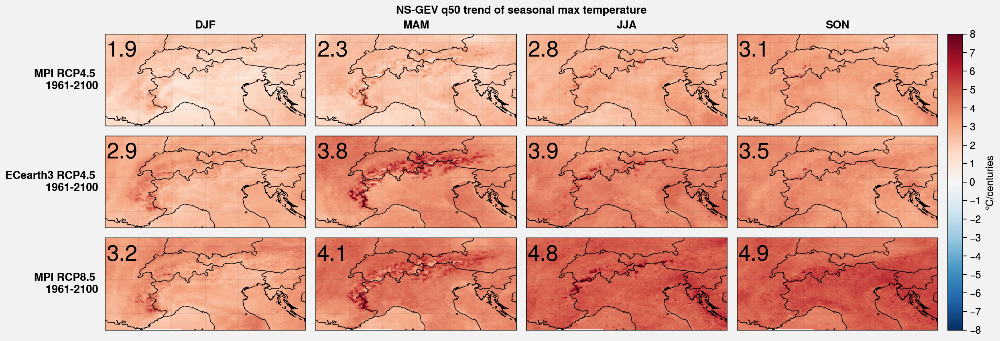

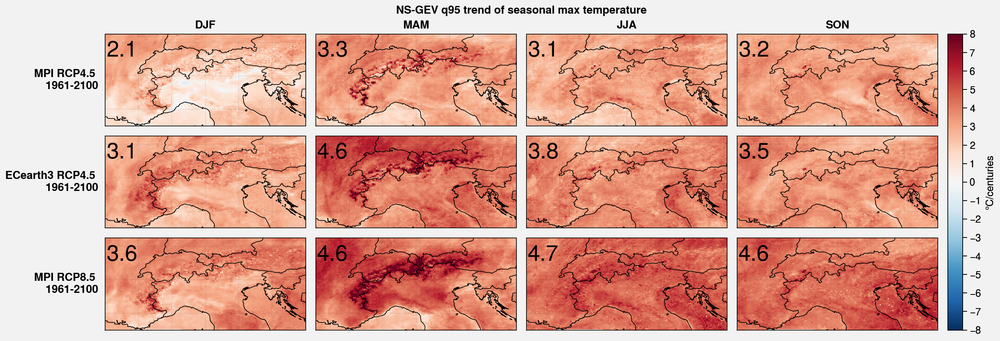

In [13]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_modelsT.npy')[:3]
for trend in [True]:
    for q in [5,50,95]:
        f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
        for m,params in enumerate(nsgev_models):
            for i in range(4):
                ax = axs[i+m*4]
                Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
                if trend:
                    Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
                    cb = ax.pcolormesh(lon,lat,100*Qt,levels=np.linspace(-8,8,129),cmap='RdBu_r')
                    signif=np.where(params[i,:,:,5]<0.05,True,False)
                    # ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
                    ax.text(5,47.5,"{:.1f}".format(np.mean(100*Qt)),ha='center',va='center',fontsize=20)
                else:
                    cb = ax.pcolormesh(lon,lat,Q0,levels=np.linspace(0,50,21),cmap='coolwarm')
        if trend: f.colorbar(cb, label= '°C/centuries',ticks=np.linspace(-8,8,17))  
        else: f.colorbar(cb, label= '°C')            
        models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100']
        axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' trend of seasonal max temperature',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

1.0

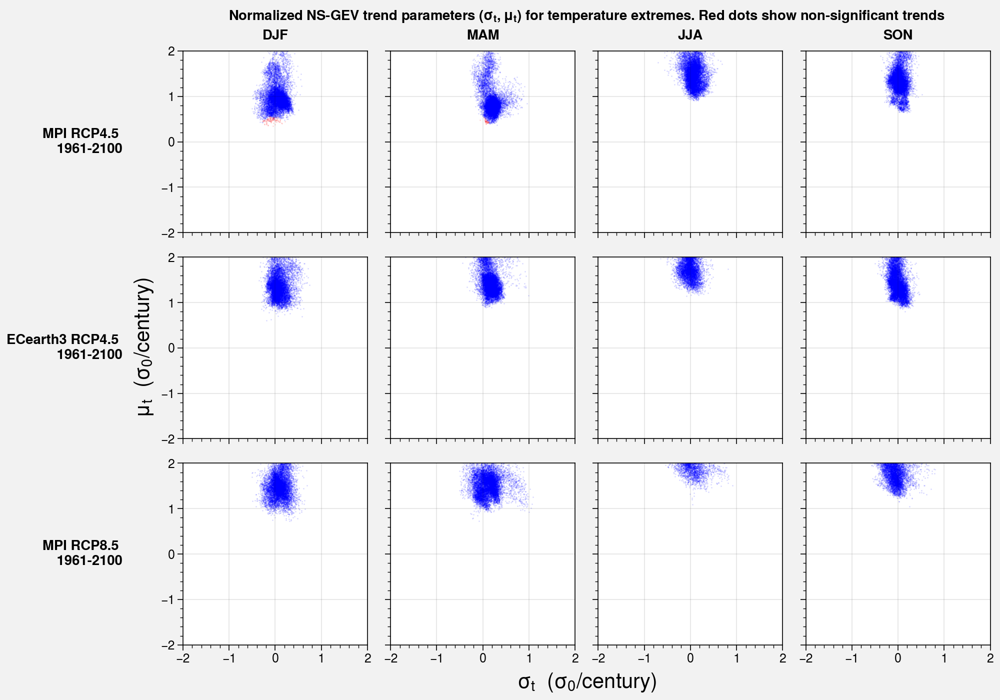

In [25]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_modelsT.npy')[:3]
# nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_models2020.npy')
# nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_models.npy')[:3]

# f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
# for m,params in enumerate(nsgev_models):
#     for i in range(4):
#         ax = axs[i+m*4]
#         cb = ax.pcolormesh(lon,lat,params[i,:,:,2],levels=np.linspace(-0.5,0.5,21),cmap='bwr')
#         signif=np.where(params[i,:,:,5]<0.05,True,False)
#         ax.contourf(lon,lat,signif,hatches=["", "...."], alpha=0.)
# f.colorbar(cb, label= None)            
# models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100']
# axs.format(**multiplot_format,suptitle='NS-GEV ξ',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

f, axs = pplt.subplots(figsize=(10,7),ncols=4, nrows=len(nsgev_models))
for m,params in enumerate(nsgev_models):
    for i in range(4):
        ax = axs[i+m*4]
        signif=np.where(params[i,:,:,5]<0.05,True,False)
        notsignif=np.where(params[i,:,:,5]>0.05,True,False)
        mu_ = 100*params[i,:,:,3]/params[i,:,:,1]
        si_ = 100*params[i,:,:,4]/params[i,:,:,1]
        ax.scatter(np.ndarray.flatten(si_[signif],order='F'),np.ndarray.flatten(mu_[signif],order='F'),marker='.',alpha=0.1,color='b',s=1)
        ax.scatter(np.ndarray.flatten(si_[notsignif],order='F'),np.ndarray.flatten(mu_[notsignif],order='F'),marker='.',alpha=0.1,color='r',s=1)
        ax.set_xlim([-2,2])
        ax.set_ylim([-2,2])
        ax.set_xlabel('$\sigma_t$  $(\sigma_0 / century)$',fontsize=15)
        ax.set_ylabel('$\mu_t$  $(\sigma_0 / century)$',fontsize=15)
models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100']
axs.format(suptitle='Normalized NS-GEV trend parameters $(\sigma_t ,\mu_t)$ for temperature extremes. Red dots show non-significant trends',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

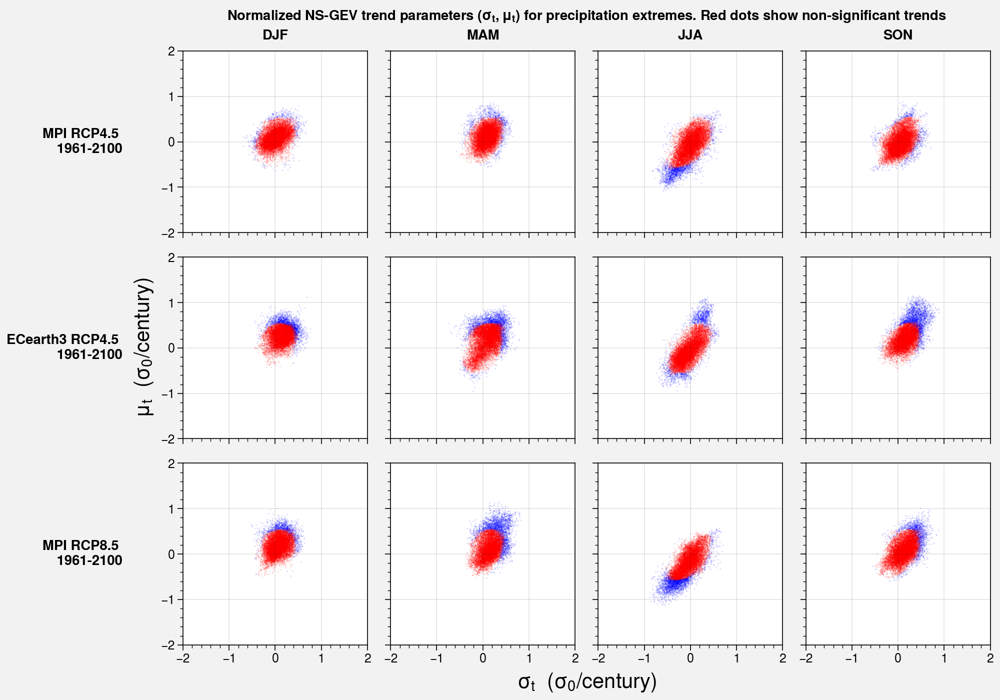

In [24]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_models.npy')[:3]

f, axs = pplt.subplots(figsize=(10,7),ncols=4, nrows=len(nsgev_models))
for m,params in enumerate(nsgev_models):
    for i in range(4):
        ax = axs[i+m*4]
        signif=np.where(params[i,:,:,5]<0.05,True,False)
        notsignif=np.where(params[i,:,:,5]>0.05,True,False)
        mu_ = 100*params[i,:,:,3]/params[i,:,:,1]
        si_ = 100*params[i,:,:,4]/params[i,:,:,1]
        ax.scatter(np.ndarray.flatten(si_[signif],order='F'),np.ndarray.flatten(mu_[signif],order='F'),marker='.',alpha=0.1,color='b',s=1)
        ax.scatter(np.ndarray.flatten(si_[notsignif],order='F'),np.ndarray.flatten(mu_[notsignif],order='F'),marker='.',alpha=0.1,color='r',s=1)
        ax.set_xlim([-2,2])
        ax.set_ylim([-2,2])
        ax.set_xlabel('$\sigma_t$  $(\sigma_0 / century)$',fontsize=15)
        ax.set_ylabel('$\mu_t$  $(\sigma_0 / century)$',fontsize=15)
models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100']
axs.format(suptitle='Normalized NS-GEV trend parameters $(\sigma_t ,\mu_t)$ for precipitation extremes. Red dots show non-significant trends',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

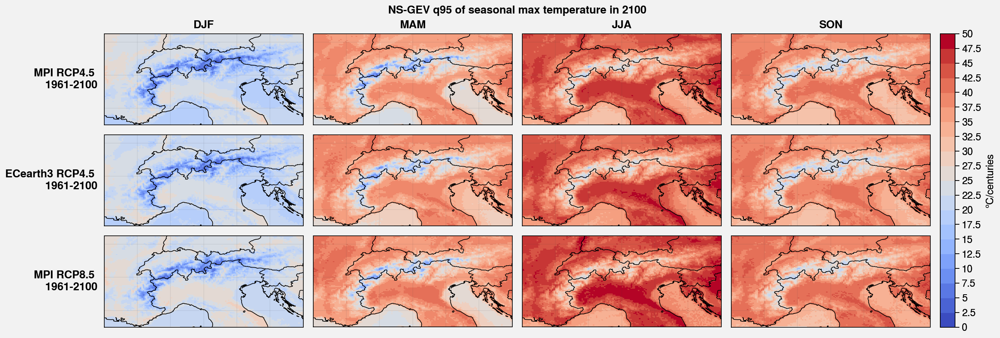

In [24]:
nsgev_models = np.load('/home/philinat/Stage-M2/saved_nsgev/nsgev_modelsT.npy')[:3]
for q in [95]:
    f, axs = pplt.subplots(proj='cyl',ncols=4, nrows=len(nsgev_models))
    for m,params in enumerate(nsgev_models):
        for i in range(4):
            ax = axs[i+m*4]
            Q0 = Qgev(params[i,:,:,0],params[i,:,:,1],params[i,:,:,2],q/100)
            Qt = Qgev(params[i,:,:,3],params[i,:,:,4],params[i,:,:,2],q/100)
            cb = ax.pcolormesh(lon,lat,Q0+70*Qt,levels=np.linspace(0,50,21),cmap='coolwarm')
            
    if trend: f.colorbar(cb, label= '°C/centuries')  
    else: f.colorbar(cb, label= '°C')            
    models = ['MPI RCP4.5 \n 1961-2100','ECearth3 RCP4.5 \n 1961-2100','MPI RCP8.5 \n 1961-2100']
    axs.format(**multiplot_format,suptitle='NS-GEV q'+str(q)+' of seasonal max temperature in 2100',collabels=['DJF','MAM','JJA', 'SON'],rowlabels=models)

In [20]:
@njit()
def fit_gev(x):
    μ,σ = fit_gumbel(x)
    return nelder_mead(gev_nllh, np.array([μ,σ,0.]),args=(x,),step=0.05,no_improve_thr=1e-6)[0]
@njit()
def sliding_gev(x,n=25,m=10):
    quantiles=[0.05,0.5,0.95]
    nt = np.shape(x)[0]
    q = np.zeros((nt,len(quantiles)))
    shift = int(n/2)
    for i in range(nt):
        if i<shift :
            μ,σ,ξ = fit_gev(x[:n])
        elif i>=nt-n+shift:
            μ,σ,ξ = fit_gev(x[-n:])
        else:
            μ,σ,ξ = fit_gev(x[i-shift:i-shift+n])
        for j,p in enumerate(quantiles):
            if np.abs(ξ) > 10**-5:
                q[i,j] = μ + σ/ξ*( (-np.log(p))**(-ξ) -1 )
            else:
                q[i,j] = μ - σ*np.log(-np.log(p))
    sm = int(m/2)
    for i in range(nt):
        if i>=sm and i<nt-m+sm:
            for j in range(len(quantiles)):
                q[i,j] = np.mean(q[i-sm:i-sm+m,j])
            
    return q

2 37
29.628594566204676 1.2975180942136086 -0.251281449260348
3 23
37.299578198815944 1.7069184835570206 -0.21198139838399344
1 60
29.030982168568162 1.086962160440064 -0.17890272388766634
1 20
32.332365561518245 1.3657826082263749 -0.15136941674306084


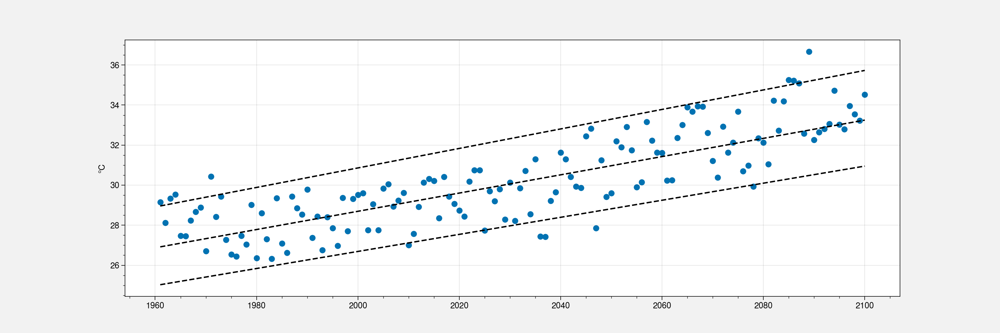

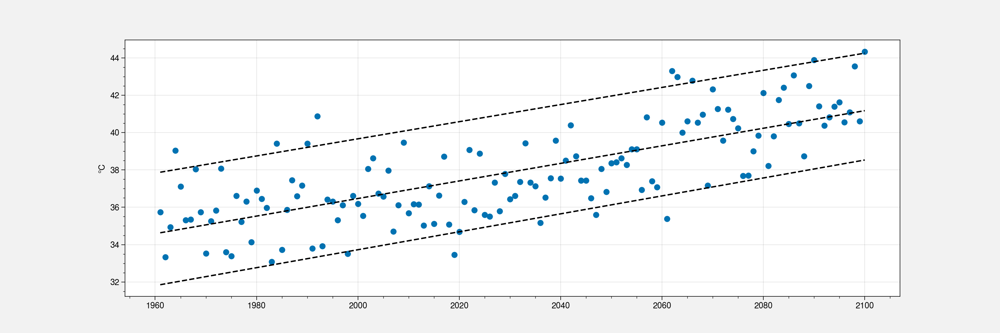

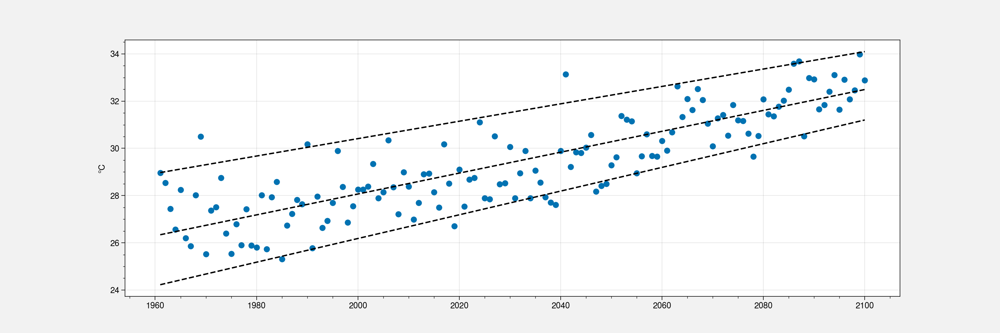

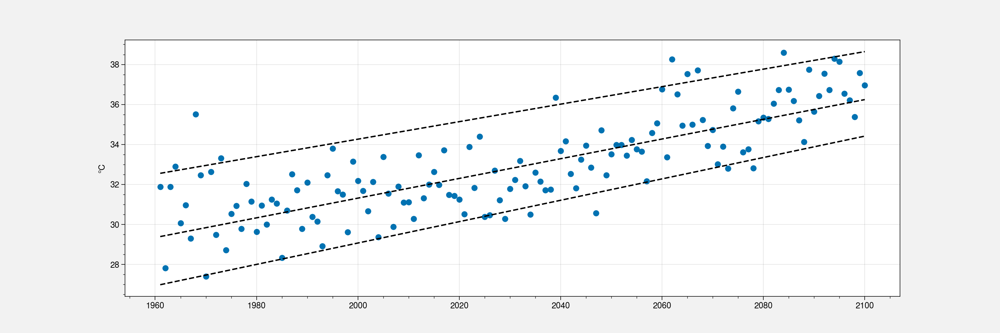

In [5]:
les_season_max = np.load('/home/philinat/Stage-M2/saved_data_MAR_MPI85/les_season_maxT.npy')[:,:,jmin:jmax,imin:imax]
t = np.arange(1961,2101,1)

for lama in range(4):
    a = np.random.randint(np.shape(les_season_max)[1])
    b = np.random.randint(np.shape(les_season_max)[2])
    print(a,b)                      
    x = les_season_max[:,2,a,b]


    plt.figure(figsize=(15,5))
    plt.scatter(t,x)

    # qq = sliding_gev(x)
    # for j in range(3):
    #     plt.plot(t,qq[:,j],'-k')

    μ,σ,ξ,μt,σt = fit_nsgev(x)[0]
    print(μ,σ,ξ)
    quantiles=[0.05,0.5,0.95]
    nt = len(x)
    # for j,p in enumerate(quantiles):
    #     plt.axhline(μ + σ/ξ*( (-np.log(p))**(-ξ) -1 ))
    for j,p in enumerate(quantiles):
        start = (μ-nt/2*μt + (σ-nt/2*σt)/ξ*( (-np.log(p))**(-ξ) -1 ))
        end = (μ+nt/2*μt + (σ+nt/2*σt)/ξ*( (-np.log(p))**(-ξ) -1 ))
        plt.plot([t[0],t[-1]],[start,end],'--k')
    plt.ylabel('°C')

In [23]:
t

0

1 16
14.513393741131903 8.051998040652473 0.31053486270722935
3 39
15.916977305190843 8.162778941223106 0.30557439140596426
3 17
14.567783085880993 7.955022307015526 0.3282787499970062
1 47
16.230071160102177 8.229861665388713 0.34883815891125514


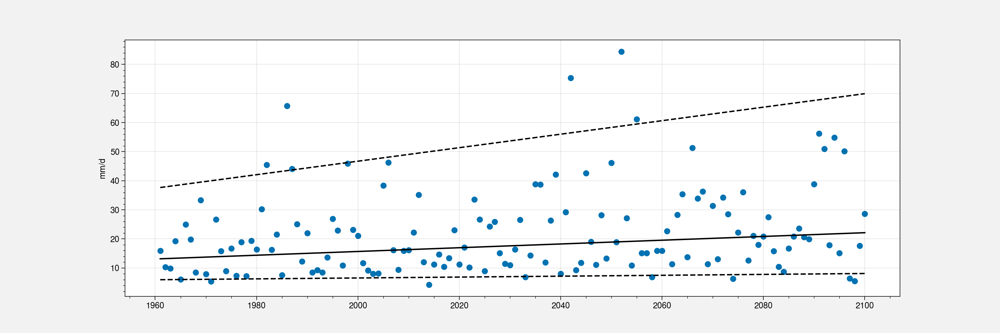

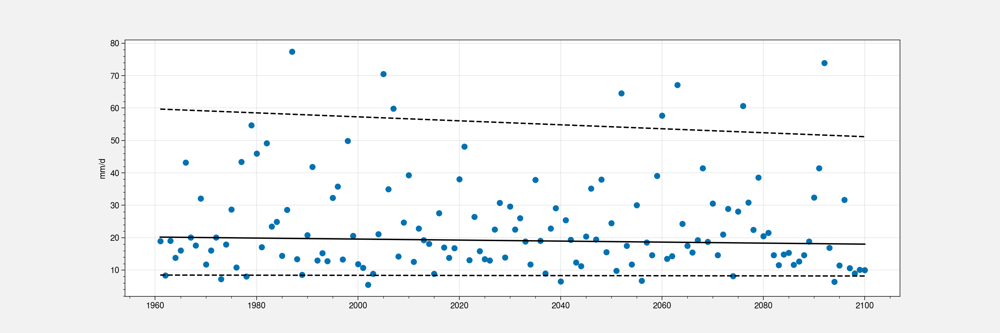

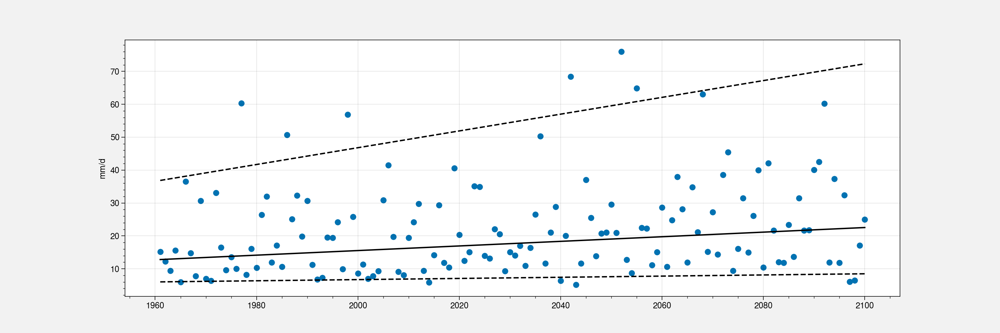

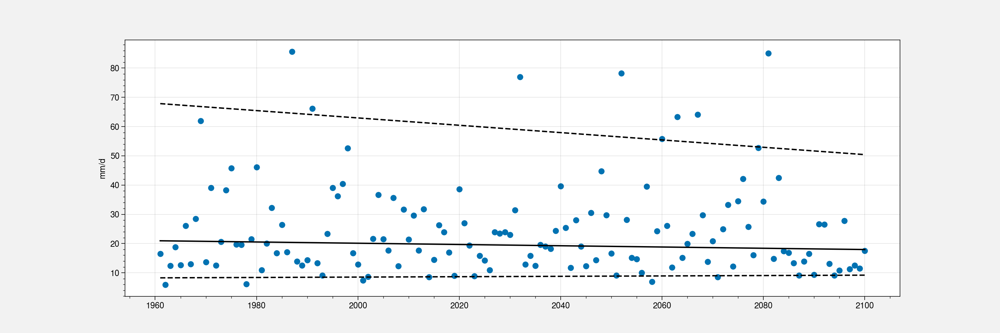

In [7]:
les_season_max = np.load('/home/philinat/Stage-M2/saved_data_MAR_MPI85/les_season_max.npy')[:,:,jmin:jmax,imin:imax]
t = np.arange(1961,2101,1)

for lama in range(4):
    a = np.random.randint(np.shape(les_season_max)[1])
    b = np.random.randint(np.shape(les_season_max)[2])
    
    # a=3 ; b=8
    print(a,b)                      
    x = les_season_max[:,3,a,b]


    plt.figure(figsize=(15,5))
    plt.scatter(t,x)

    # qq = sliding_gev(x)
    # for j in range(3):
    #     plt.plot(t,qq[:,j],'-k')

    μ,σ,ξ,μt,σt = fit_nsgev(x)[0]
    print(μ,σ,ξ)
    quantiles=[0.05,0.5,0.95]
    nt = len(x)
    # for j,p in enumerate(quantiles):
    #     plt.axhline(μ + σ/ξ*( (-np.log(p))**(-ξ) -1 ))
    for j,p in enumerate(quantiles):
        start = (μ-nt/2*μt + (σ-nt/2*σt)/ξ*( (-np.log(p))**(-ξ) -1 ))
        end = (μ+nt/2*μt + (σ+nt/2*σt)/ξ*( (-np.log(p))**(-ξ) -1 ))
        plt.plot([t[0],t[-1]],[start,end],['--k','-k','--k'][j])
    plt.ylabel('mm/d')